# Поиск ближайшего населенного пункта для пожаров

In [37]:
import fiona
import geopandas as gpd
import pandas as pd
from shapely.geometry import LineString, Point, Polygon
import shapely

In [2]:
df_fires = pd.read_csv('data/fires.csv')

In [3]:
df_fires = gpd.GeoDataFrame(df_fires, geometry = gpd.GeoSeries.from_wkt(df_fires['poly_wkt']))

In [4]:
df_loc = pd.read_csv('../collecting the borders of localities/data/localities.csv')

In [5]:
df = gpd.GeoDataFrame(df_loc.loc[~df_loc.poly_wkt.isna()], geometry = gpd.GeoSeries.from_wkt(df_loc.loc[~df_loc.poly_wkt.isna(), 'poly_wkt']))

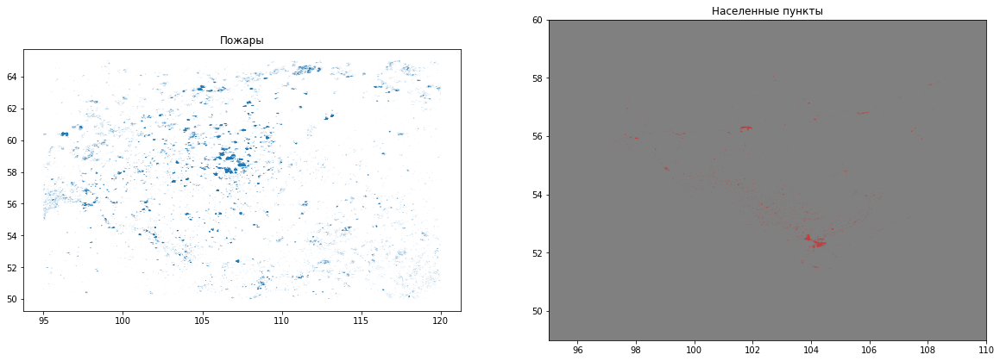

In [6]:
%matplotlib inline
import matplotlib.pyplot as plt

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 10))


df_fires.plot(ax=axes[0], markersize=0.2, alpha=0.5)
axes[0].set_title('Пожары')

df.loc[df.id.astype(int)!=df.id].plot(ax=axes[1], markersize=0.2, alpha=0.5, color='red')
axes[1].set_title('Населенные пункты')
axes[1].set_xlim(95, 110)
axes[1].set_ylim(49, 60)
axes[1].set_facecolor('gray')

In [7]:
from sklearn.neighbors import BallTree
import numpy as np

def get_nearest(src_points, candidates, k_neighbors=1):
    """Find nearest neighbors for all source points from a set of candidate points"""

    # Create tree from the candidate points
    tree = BallTree(candidates, leaf_size=15, metric='haversine')

    # Find closest points and distances
    distances, indices = tree.query(src_points, k=k_neighbors)

    # Transpose to get distances and indices into arrays
    distances = distances.transpose()
    indices = indices.transpose()

    # Get closest indices and distances (i.e. array at index 0)
    # note: for the second closest points, you would take index 1, etc.
    closest = indices[0]
    closest_dist = distances[0]

    # Return indices and distances
    return (closest, closest_dist)


def nearest_neighbor(left_gdf, right_gdf, return_dist=False):
    """
    For each point in left_gdf, find closest point in right GeoDataFrame and return them.
    
    NOTICE: Assumes that the input Points are in WGS84 projection (lat/lon).
    """
    
    left_geom_col = left_gdf.geometry.name
    right_geom_col = right_gdf.geometry.name
    
    # Ensure that index in right gdf is formed of sequential numbers
    right = right_gdf.copy().reset_index(drop=True)
    
    # Parse coordinates from points and insert them into a numpy array as RADIANS
    # Notice: should be in Lat/Lon format 
    left_radians = np.array(left_gdf[left_geom_col].centroid.apply(lambda geom: (geom.y * np.pi / 180, geom.x * np.pi / 180)).to_list())
    right_radians = np.array(right[right_geom_col].centroid.apply(lambda geom: (geom.y * np.pi / 180, geom.x * np.pi / 180)).to_list())
    
    # Find the nearest points
    # -----------------------
    # closest ==> index in right_gdf that corresponds to the closest point
    # dist ==> distance between the nearest neighbors (in meters)
    
    closest, dist = get_nearest(src_points=left_radians, candidates=right_radians)

    # Return points from right GeoDataFrame that are closest to points in left GeoDataFrame
    closest_points = right.loc[closest]
    
    # Ensure that the index corresponds the one in left_gdf
    closest_points = closest_points.reset_index(drop=True)
    
    # Add distance if requested 
    if return_dist:
        # Convert to meters from radians
        earth_radius = 6371  # kilometers
        closest_points['distance'] = dist * earth_radius
        
    return closest_points

In [8]:
closest_fires = nearest_neighbor(df_fires, df, return_dist=True)

In [9]:
print(len(closest_fires), '==', len(df_fires))

45667 == 45667


In [10]:
closest_fires.to_csv('data/distance.csv')

In [11]:
# Rename the geometry of closest fires gdf so that we can easily identify it
closest_fires.rename(columns={'geometry': 'closest_locality_geom'}, inplace = True)

# Merge the datasets by index (for this, it is good to use '.join()' -function)
df_fd = df_fires.join(closest_fires, rsuffix='_loc')

# Let's see what we have
df_fd.head()

,fire_id,dt,lat,lon,area,terr_id,since,id,is_deleted,classname,...,code,distance,ado_loc,id_loc,query,address,closest_locality_geom,poly_wkt_loc,poly_loc,valid
0,13073,2019/04/27 12:13:30,53.4228,103.092,3.1,NaN,2019/04/27 23:01:34,29662,f,NaN,...,25123934005,0.645077,Аларский,1.80,Аргалей деревня Аларский иркутская область,"Россия, Иркутская область, Аларский район, дер...","POLYGON ((103.09073 53.42867, 103.09208 53.430...","POLYGON ((103.090733 53.428667, 103.09208 53.4...",0103000020E6100000010000000F000000C0EAC891CEC5...,1.0
1,2068,2017/04/28 06:13:22,53.3045,102.421,3.7,NaN,2017/04/28 16:31:26,3932,f,NaN,...,25123919003,0.659325,Аларский,1.17,Вершина деревня Аларский иркутская область,"Россия, Иркутская область, Аларский район, дер...","POLYGON ((102.41100 53.30261, 102.41425 53.303...","POLYGON ((102.410996 53.30260699999999, 102.41...",0103000020E610000001000000100000005BB22AC24D9A...,1.0
2,946,2017/04/19 11:27:17,53.4304,102.684,2.2,NaN,2017/04/20 09:00:51,1551,f,NaN,...,25123926004,1.106511,Аларский,1.19,Головинское село Аларский иркутская область,"Россия, Иркутская область, Аларский район, сел...","POLYGON ((102.65524 53.43184, 102.65957 53.434...","POLYGON ((102.655235 53.43183699999999, 102.65...",0103000020E61000000100000041000000730CC85EEFA9...,1.0
3,1307,2017/04/24 10:29:04,53.2938,103.034,1.6,NaN,2017/04/25 12:35:08,2200,f,NaN,...,25123918001,1.636182,Аларский,1.22,Егоровская деревня Аларский иркутская область,"Россия, Иркутская область, Аларский район, дер...","POLYGON ((103.00397 53.30652, 103.00581 53.307...","POLYGON ((103.003968 53.306518, 103.00581 53.3...",0103000020E6100000010000002E000000C18EFF0241C0...,1.0
4,1880,2017/04/27 11:34:55,53.2724,102.835,1.2,NaN,2017/04/28 08:25:00,3417,f,NaN,...,25123914001,0.557586,Аларский,1.24,Забитуй поселок Аларский иркутская область,"Россия, Иркутская область, Аларский район, пос...","POLYGON ((102.81174 53.28177, 102.81286 53.282...","POLYGON ((102.811741 53.281771, 102.81286 53.2...",0103000020E61000000100000046000000A1F48590F3B3...,1.0


In [12]:
df_fd['distance'].describe()

count    45667.000000
mean       155.052911
std        168.429515
min          0.051514
25%         39.319683
50%         69.654491
75%        244.216391
max        866.042766
Name: distance, dtype: float64

In [25]:
df_fd['HubDist'].describe()

count    45667.000000
mean       168.982755
std        183.322028
min          0.096481
25%         41.137135
50%         76.161659
75%        261.016893
max        867.173429
Name: HubDist, dtype: float64

Дистанции, полученные через QGIS и этим методом примерно равны

<AxesSubplot:>

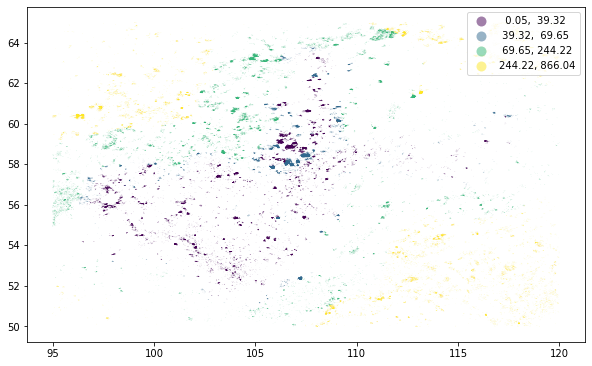

In [13]:
df_fd.plot(column='distance', markersize=0.2, alpha=0.5, figsize=(10,10), scheme='quantiles', k=4, legend=True)

In [15]:
# Create a link (LineString) between building and stop points
df_fd['link'] = df_fd.apply(lambda row: LineString([row['geometry'].centroid.coords[0], row['closest_locality_geom'].centroid.coords[0]]), axis=1)

# Set link as the active geometry
fires_links = df_fd.copy()
fires_links = fires_links.set_geometry('link')

In [16]:
pd_fl = pd.DataFrame(fires_links)

In [17]:
pd_fl['distance_interval'] = pd.cut(pd_fl.distance, bins = [0,39.319683,69.654491,244.216391,866.1], labels=['1','2','3','4'])

In [18]:
df = df.loc[df.id.astype(int)!=df.id]

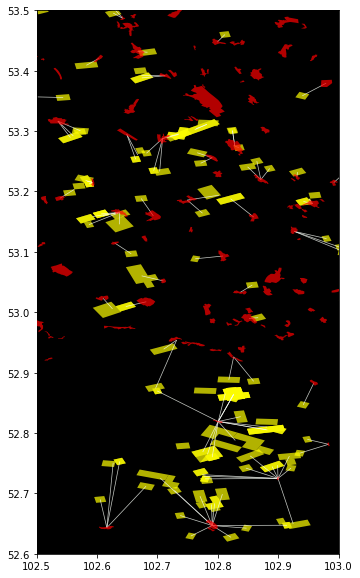

In [19]:
ax = fires_links.plot(column='distance', cmap='Greens', scheme='quantiles', k=4, alpha=0.8, lw=0.7, figsize=(13, 10))
ax = df_fd.plot(ax=ax, color='yellow', markersize=1, alpha=0.7)
ax = df.plot(ax=ax, markersize=4, marker='o', color='red', alpha=0.7, zorder=3)

# Zoom closer
ax.set_ylim([52.6, 53.5])
ax.set_xlim([102.5, 103])

# Set map background color to black, which helps with contrast
ax.set_facecolor('black')

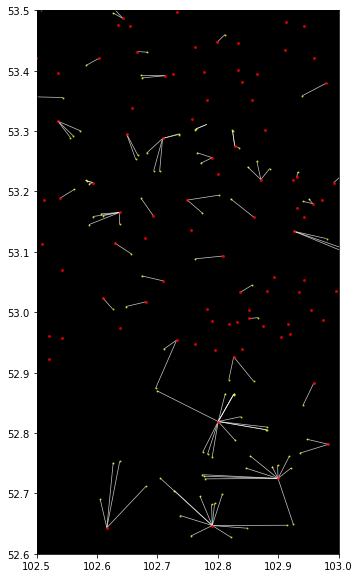

In [20]:
# Plot the connecting links between buildings and stops and color them based on distance
ax = fires_links.plot(column='distance', cmap='Greens', scheme='quantiles', k=4, alpha=0.8, lw=0.7, figsize=(13, 10))
ax = df_fd.centroid.plot(ax=ax, color='yellow', markersize=1, alpha=0.7)
ax = df.centroid.plot(ax=ax, markersize=4, marker='o', color='red', alpha=0.7, zorder=3)

# Zoom closer
ax.set_ylim([52.6, 53.5])
ax.set_xlim([102.5, 103])

# Set map background color to black, which helps with contrast
ax.set_facecolor('black')

In [28]:
fires_links.columns

Index(['fire_id', 'dt', 'lat', 'lon', 'area', 'terr_id', 'since', 'id',
       'is_deleted', 'classname', 'created_by', 'edited_by', 'edited_on',
       'created_on', 'published', 'poly', 'ado', 'local_id', 'locality_name',
       'locality_id', 'HubName', 'HubDist', 'in_locality', 'poly_wkt',
       'geometry', 'name', 'type', 'name_MO', 'code', 'distance', 'ado_loc',
       'id_loc', 'query', 'address', 'closest_locality_geom', 'poly_wkt_loc',
       'poly_loc', 'valid', 'link', 'distance_interval'],
      dtype='object')

In [29]:
fires_links.drop(columns = ['terr_id', 'edited_by', 'edited_on'], inplace = True)

In [30]:
fires_links

,fire_id,dt,lat,lon,area,since,id,is_deleted,classname,created_by,...,ado_loc,id_loc,query,address,closest_locality_geom,poly_wkt_loc,poly_loc,valid,link,distance_interval
0,13073,2019/04/27 12:13:30,53.4228,103.092,3.1,2019/04/27 23:01:34,29662,f,NaN,NaN,...,Аларский,1.80,Аргалей деревня Аларский иркутская область,"Россия, Иркутская область, Аларский район, дер...","POLYGON ((103.09073 53.42867, 103.09208 53.430...","POLYGON ((103.090733 53.428667, 103.09208 53.4...",0103000020E6100000010000000F000000C0EAC891CEC5...,1.0,"LINESTRING (103.09172 53.42280, 103.09655 53.4...",1
1,2068,2017/04/28 06:13:22,53.3045,102.421,3.7,2017/04/28 16:31:26,3932,f,NaN,NaN,...,Аларский,1.17,Вершина деревня Аларский иркутская область,"Россия, Иркутская область, Аларский район, дер...","POLYGON ((102.41100 53.30261, 102.41425 53.303...","POLYGON ((102.410996 53.30260699999999, 102.41...",0103000020E610000001000000100000005BB22AC24D9A...,1.0,"LINESTRING (102.42067 53.30452, 102.42187 53.2...",1
2,946,2017/04/19 11:27:17,53.4304,102.684,2.2,2017/04/20 09:00:51,1551,f,NaN,NaN,...,Аларский,1.19,Головинское село Аларский иркутская область,"Россия, Иркутская область, Аларский район, сел...","POLYGON ((102.65524 53.43184, 102.65957 53.434...","POLYGON ((102.655235 53.43183699999999, 102.65...",0103000020E61000000100000041000000730CC85EEFA9...,1.0,"LINESTRING (102.68365 53.43041, 102.66705 53.4...",1
3,1307,2017/04/24 10:29:04,53.2938,103.034,1.6,2017/04/25 12:35:08,2200,f,NaN,NaN,...,Аларский,1.22,Егоровская деревня Аларский иркутская область,"Россия, Иркутская область, Аларский район, дер...","POLYGON ((103.00397 53.30652, 103.00581 53.307...","POLYGON ((103.003968 53.306518, 103.00581 53.3...",0103000020E6100000010000002E000000C18EFF0241C0...,1.0,"LINESTRING (103.03427 53.29381, 103.01614 53.3...",1
4,1880,2017/04/27 11:34:55,53.2724,102.835,1.2,2017/04/28 08:25:00,3417,f,NaN,NaN,...,Аларский,1.24,Забитуй поселок Аларский иркутская область,"Россия, Иркутская область, Аларский район, пос...","POLYGON ((102.81174 53.28177, 102.81286 53.282...","POLYGON ((102.811741 53.281771, 102.81286 53.2...",0103000020E61000000100000046000000A1F48590F3B3...,1.0,"LINESTRING (102.83512 53.27235, 102.82809 53.2...",1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45662,12703,2019/05/26 23:19:43,58.1389,107.077,17.8,2019/05/27 10:01:02,31076,f,NaN,NaN,...,Киренский,15.70,Верхнекарелина деревня Киренский иркутская обл...,"Россия, Иркутская область, Киренский район, де...","POLYGON ((107.76631 57.86667, 107.77410 57.868...","POLYGON ((107.766313 57.866674, 107.774097 57....",0103000020E61000000100000017000000FA5FAE450BF1...,1.0,"LINESTRING (107.07639 58.13904, 107.77563 57.8...",2
45663,13875,2019/07/04 02:27:59,58.4443,107.589,22.0,2019/07/04 12:02:44,32302,f,NaN,NaN,...,Катангский,13.10,Бур село Катангский иркутская область,"Россия, Иркутская область, Катангский район, с...","POLYGON ((106.97783 58.81732, 106.97925 58.817...","POLYGON ((106.977831 58.817316, 106.979254 58....",0103000020E61000000100000024000000F58079C894BE...,1.0,"LINESTRING (107.58797 58.44416, 106.99481 58.8...",2
45664,13875,2019/07/04 02:27:58,58.4445,107.589,22.2,2019/07/04 12:02:44,32301,f,NaN,NaN,...,Катангский,13.10,Бур село Катангский иркутская область,"Россия, Иркутская область, Катангский район, с...","POLYGON ((106.97783 58.81732, 106.97925 58.817...","POLYGON ((106.977831 58.817316, 106.979254 58....",0103000020E61000000100000024000000F58079C894BE...,1.0,"LINESTRING (107.58811 58.44437, 106.99481 58.8...",2
45665,13840,2019/07/05 02:16:14,58.4355,107.385,30.2,2019/07/05 11:32:59,32515,f,NaN,NaN,...,Катангский,13.10,Бур село Катангский иркутская область,"Россия, Иркутская область, Катангский район, с...","POLYGON ((106.97783 58.81732, 106.97925 58.817...","POLYGON ((106.977831 58.817316, 106.979254 58....",0103000020E61000000100000024000000F58079C894BE...,1.0,"LINESTRING (107.38473 58.43601, 106.99481 58.8...",2


In [31]:
pd_fl.to_csv('data/fires_links.csv', index = False)

In [32]:
import folium
import branca

In [33]:
color_dict = {'1':'#a17fa9', '2':'#97b3c6', '3':'#99dabb', '4':'#fdf291'}

In [46]:
fires_links.loc[~fires_links.local_id.isna(), 'distance'].describe()

count    23047.000000
mean        35.843353
std         23.786294
min          0.051514
25%         13.790591
50%         40.934620
75%         51.294004
max        146.312453
Name: distance, dtype: float64

In [115]:
m = folium.Map(location=[53, 106], zoom_start = 8, tiles='cartodbpositron')

colors = {'1':"#ffba08", "2":"#f48c06", "3":"#e85d04", "4":"#dc2f02"}
colormap = branca.colormap.StepColormap(colors.values()).scale(0, 146)
colormap.caption = 'Удаленность пожара (км)'

geo = gpd.GeoDataFrame(fires_links.loc[~fires_links.local_id.isna()][['name', 'distance']])
geo['geometry'] = gpd.GeoSeries([shapely.wkt.loads(r['poly_wkt']) for i, r in fires_links.iterrows()]).simplify(tolerance=0.07)
geo_j = geo.to_json()
folium.GeoJson(data=geo_j, style_function = lambda x: {"fillOpacity": 0.5, 'fillColor': colormap(x['properties']['distance']), 'weight':0}).add_to(m)

sim_geo = gpd.GeoSeries(df['geometry']).simplify(tolerance=0.025)
geo_j = sim_geo.to_json()
folium.GeoJson(data=geo_j, style_function = lambda x: {"fillOpacity": 0.5, 'fillColor': 'green','weight': 0}).add_to(m)

sim_geo = gpd.GeoSeries(fires_links.loc[~fires_links.local_id.isna(),'link'])
geo_j = sim_geo.to_json()
folium.GeoJson(data=geo_j, style_function = lambda x: {'fillOpacity': 0.5, 'weight': 0.5, 'color': 'black'}).add_to(m)

colormap.add_to(m)
m

In [116]:
m.save('data/distances.html')